In [1]:
# Copyright (C) 2022 Intel Corporationworkbench.action.openLargeOutput
#
# SPDX-License-Identifier: MIT

import os
import datumaro as dm
import time

from datumaro.components.searcher import Searcher
from datumaro.components.visualizer import Visualizer

## Pytorch inference

In [9]:
start_time = time.time()
# dataset = dm.Dataset.import_from('./tests/assets/coco_dataset/coco', save_hash=True)
dataset = dm.Dataset.import_from("coco_dataset", format='coco_instances', save_hash=True)
# dataset = dm.Dataset.import_from("/media/hdd1/Datasets/imagenet/val", format='imagenet', save_hash=True)
print(f'setting dataset time for {len(dataset)} items: ', time.time()-start_time)

5000it [01:00, 82.80it/s]


setting dataset time for 5000 items:  62.18896985054016


In [10]:
dataset

Dataset
	size=5000
	source_path=coco_dataset
	media_type=<class 'datumaro.components.media.Image'>
	annotated_items_count=5000
	annotations_count=83647
subsets
	val2017: # of items=5000, # of annotated items=5000, # of annotations=83647, annotation types=['hash_key', 'polygon', 'mask', 'bbox']
infos
	categories
	label: ['person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'dining table', 'toilet', 'tv', 'laptop

In [11]:
visualizer = Visualizer(dataset, figsize=(12, 12), alpha=0)
searcher = Searcher(dataset)

### Image query search

In [12]:
for i, item in enumerate(dataset):
    if i==7:
        query = item

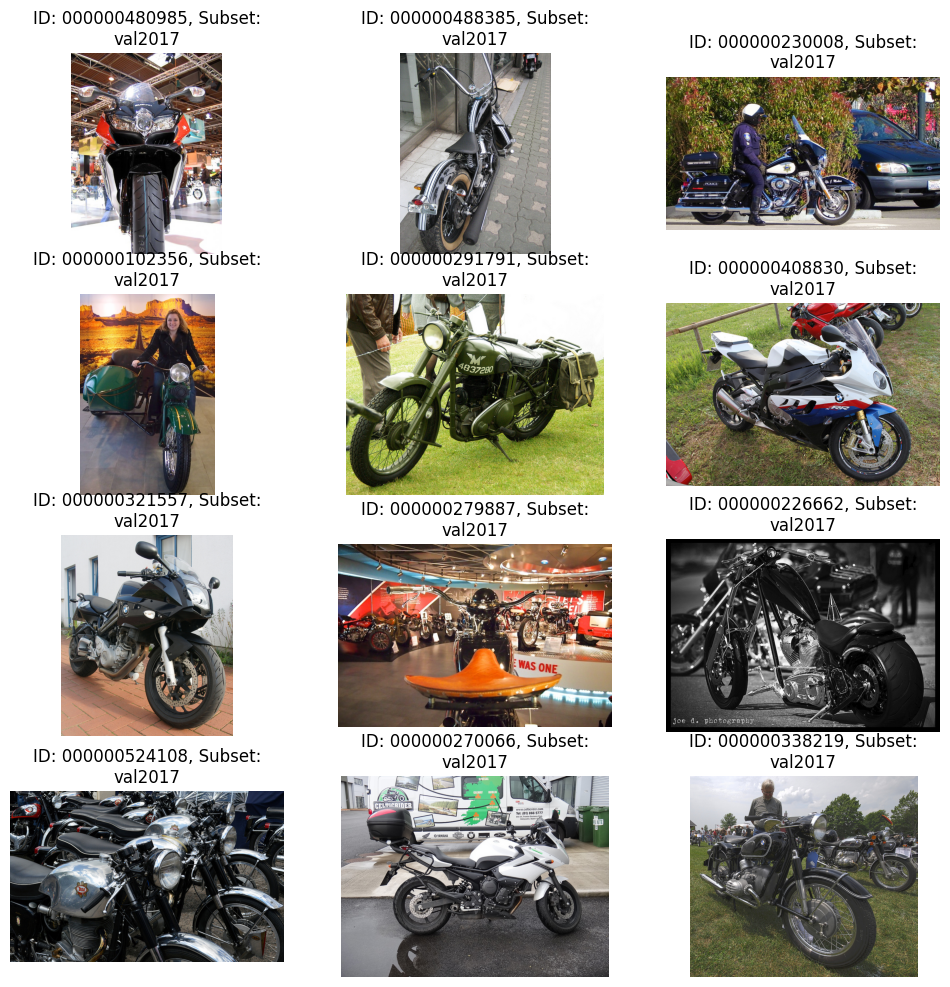

In [13]:
topk_list = searcher.search_topk(query, topk=15)
results = [query] + topk_list[1:]
subset_list = []
id_list =[]
for result in results:
    subset_list.append(result.subset)
    id_list.append(result.id)
fig = visualizer.vis_gallery(id_list[:12], subset_list[:12], (None, None))
fig.show()

### Text query search

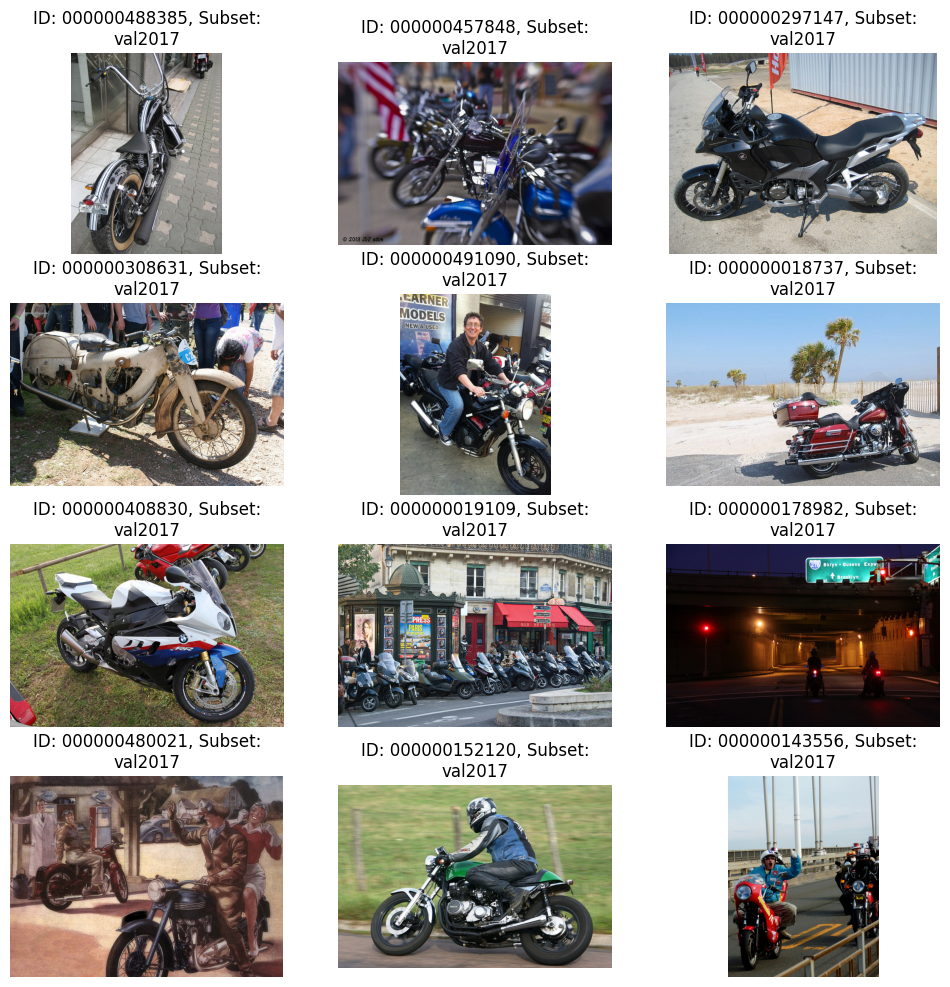

In [14]:
topk_list = searcher.search_topk('motorcycle', topk=15)
subset_list = []
id_list =[]
for result in topk_list:
    subset_list.append(result.subset)
    id_list.append(result.id)
fig = visualizer.vis_gallery(id_list[:12], subset_list[:12], (None, None))
fig.show()

### Image query list search

In [15]:
query_list = []
for i, item in enumerate(dataset):
    if i in [7, 23, 31]: # 7-motorcycle, 23-bus, 26-giraffe, 31-train
        query_list.append(item)

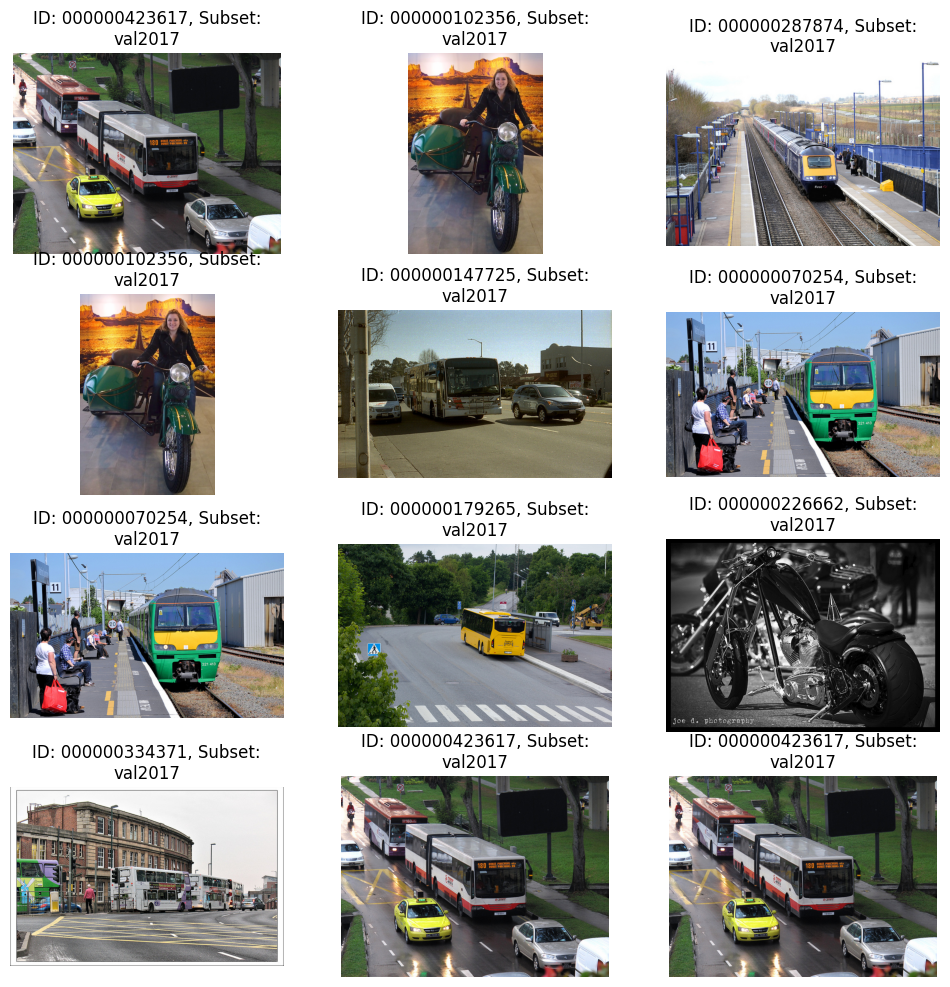

In [16]:
topk_list = searcher.search_topk(query_list, topk=15)
results = topk_list[:]
subset_list = []
id_list =[]
for result in results:
    subset_list.append(result.subset)
    id_list.append(result.id)
fig = visualizer.vis_gallery(id_list[:12], subset_list[:12], (None, None))
fig.show()

### Text query list search

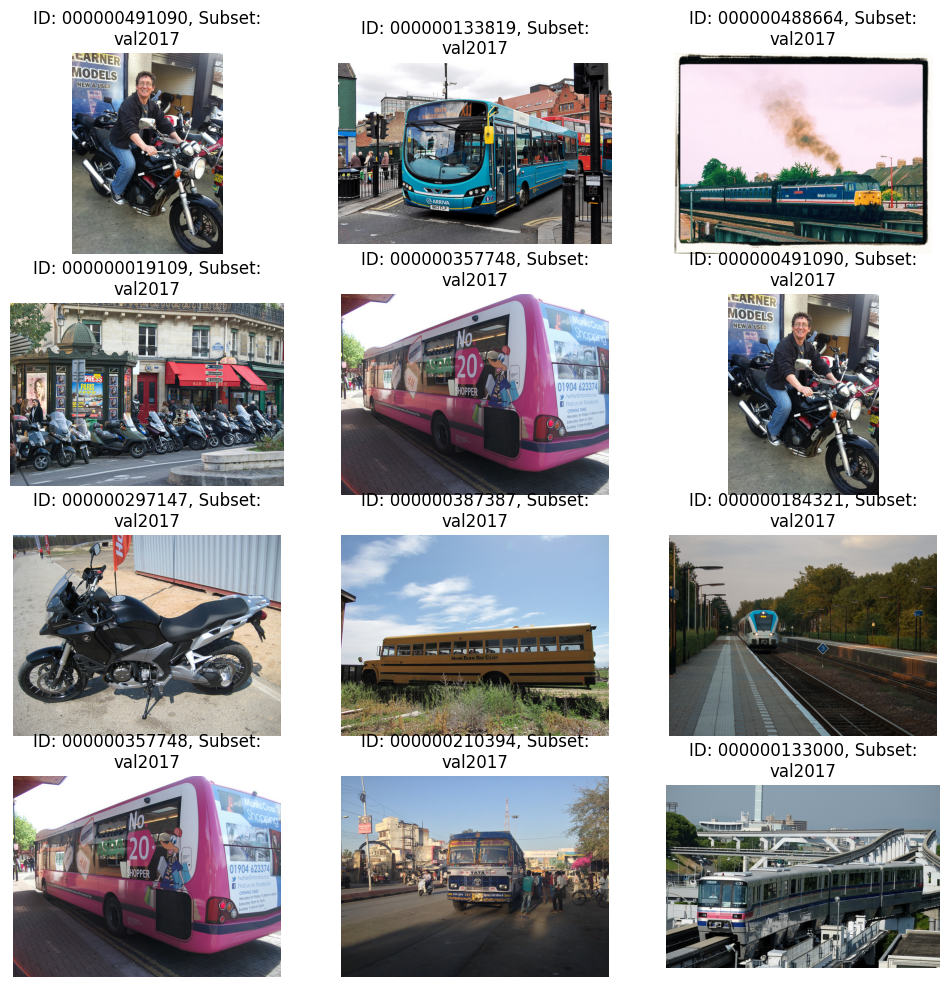

In [17]:
topk_list = searcher.search_topk(['motorcycle', 'bus', 'train'], topk=15)
results = topk_list[:]
subset_list = []
id_list =[]
for result in results:
    subset_list.append(result.subset)
    id_list.append(result.id)
fig = visualizer.vis_gallery(id_list[:12], subset_list[:12], (None, None))
fig.show()

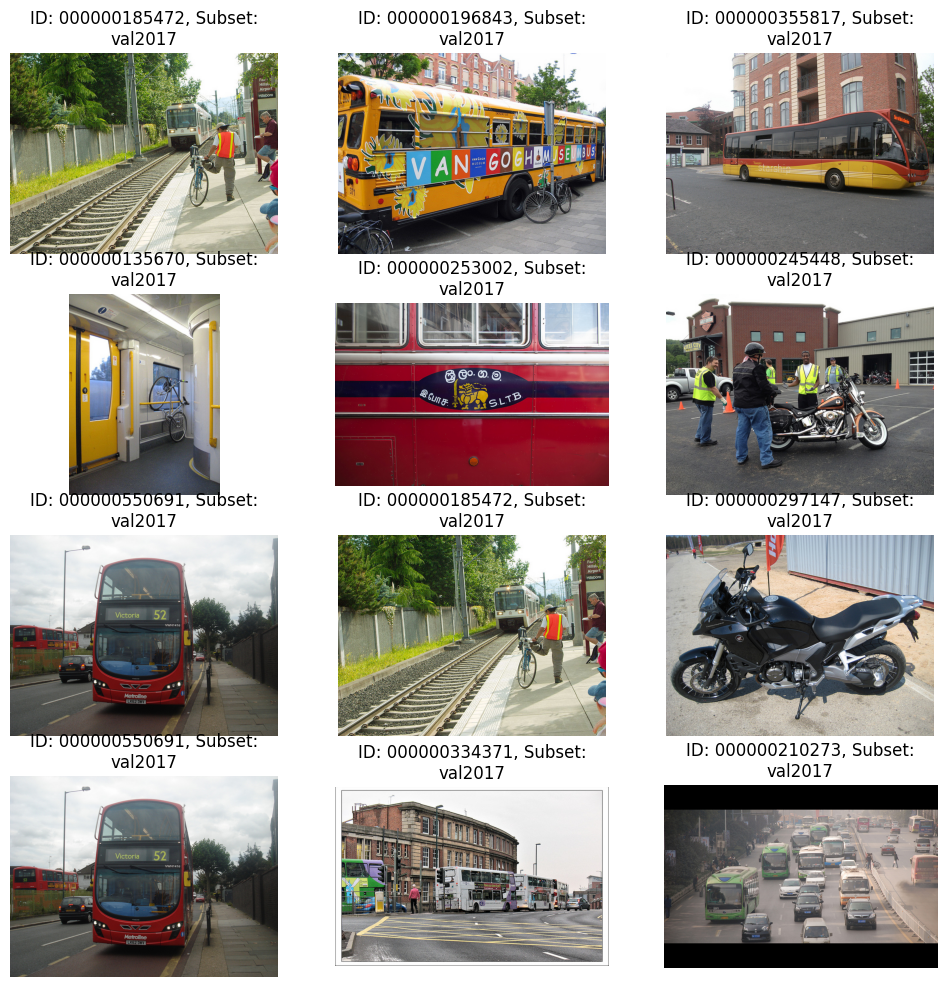

In [18]:
topk_list = searcher.search_topk(['motorcycle and bus and train'], topk=15)
results = topk_list[:]
subset_list = []
id_list =[]
for result in results:
    subset_list.append(result.subset)
    id_list.append(result.id)
fig = visualizer.vis_gallery(id_list[:12], subset_list[:12], (None, None))
fig.show()

## onnx inference

In [19]:
start_time = time.time()
# dataset = dm.Dataset.import_from('./tests/assets/coco_dataset/coco', save_hash=True)
onnx_dataset = dm.Dataset.import_from("coco_dataset", format='coco_instances', save_hash=True, hash_mode="onnx")
# dataset = dm.Dataset.import_from("/media/hdd1/Datasets/imagenet/val", format='imagenet', save_hash=True)
print(f'setting dataset time for {len(onnx_dataset)} items: ', time.time()-start_time)

5000it [18:10,  4.59it/s]


setting dataset time for 5000 items:  1092.4849734306335


In [20]:
visualizer = Visualizer(onnx_dataset, figsize=(12, 12), alpha=0)
searcher = Searcher(onnx_dataset)

### Image query search

In [21]:
for i, item in enumerate(onnx_dataset):
    if i==7:
        query = item

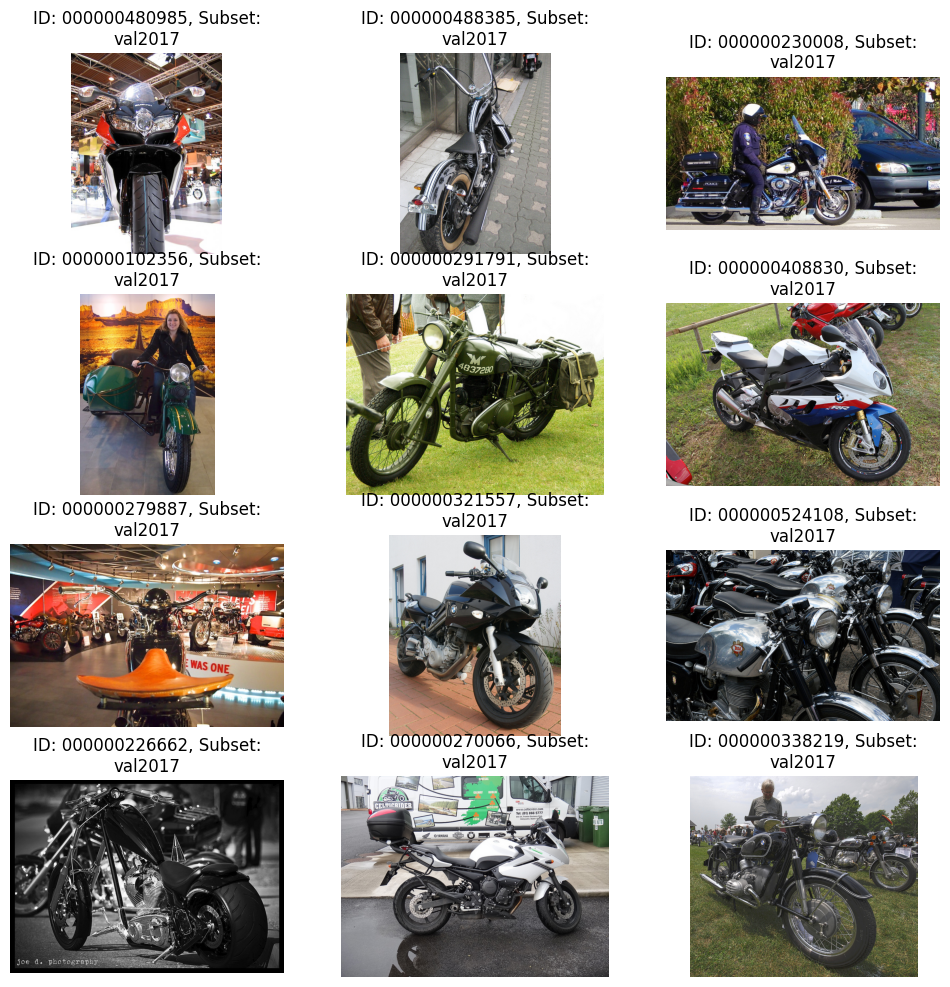

In [22]:
topk_list = searcher.search_topk(query, topk=15)
results = [query] + topk_list[1:]
subset_list = []
id_list =[]
for result in results:
    subset_list.append(result.subset)
    id_list.append(result.id)
fig = visualizer.vis_gallery(id_list[:12], subset_list[:12], (None, None))
fig.show()

### Text query search

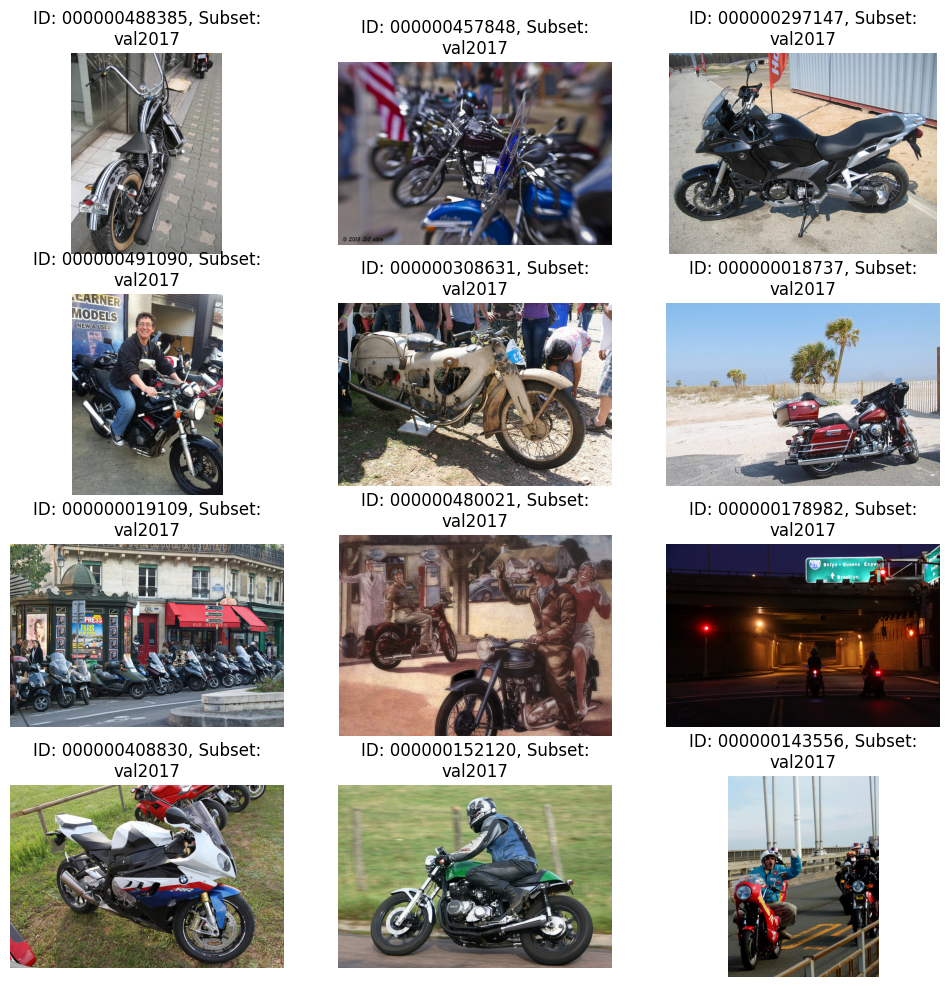

In [23]:
topk_list = searcher.search_topk('motorcycle', topk=15)
subset_list = []
id_list =[]
for result in topk_list:
    subset_list.append(result.subset)
    id_list.append(result.id)
fig = visualizer.vis_gallery(id_list[:12], subset_list[:12], (None, None))
fig.show()

### Image query list search

In [24]:
query_list = []
for i, item in enumerate(dataset):
    if i in [7, 23, 31]: # 7-motorcycle, 23-bus, 26-giraffe, 31-train
        query_list.append(item)

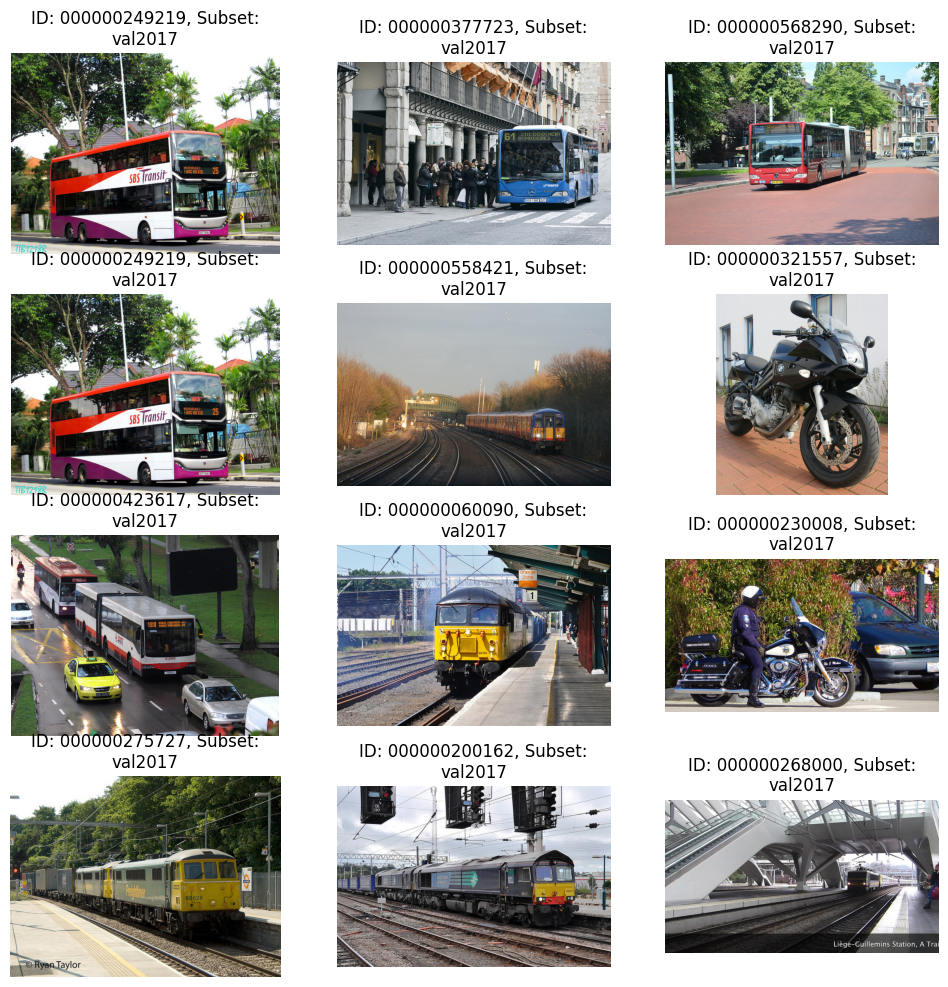

In [25]:
topk_list = searcher.search_topk(query_list, topk=15)
results = topk_list[:]
subset_list = []
id_list =[]
for result in results:
    subset_list.append(result.subset)
    id_list.append(result.id)
fig = visualizer.vis_gallery(id_list[:12], subset_list[:12], (None, None))
fig.show()

### Text queary list search

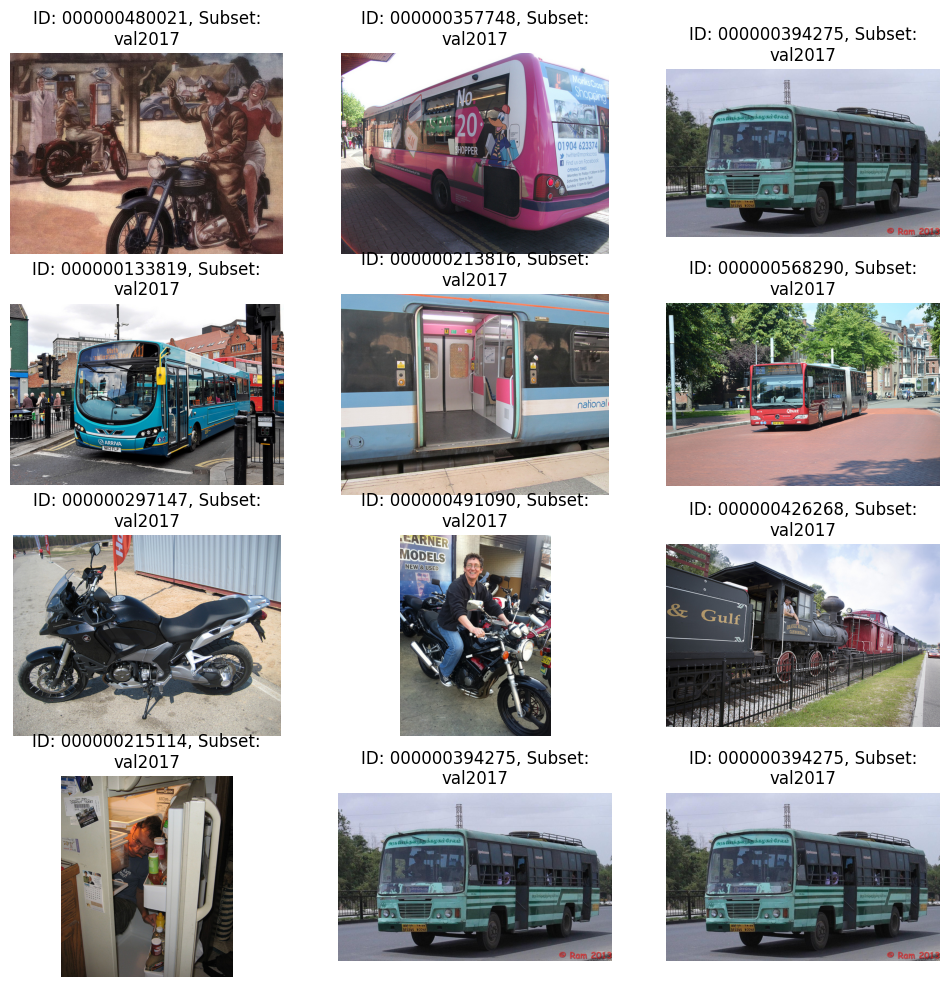

In [26]:
topk_list = searcher.search_topk(['motorcycle', 'bus', 'train'], topk=15)
results = topk_list[:]
subset_list = []
id_list =[]
for result in results:
    subset_list.append(result.subset)
    id_list.append(result.id)
fig = visualizer.vis_gallery(id_list[:12], subset_list[:12], (None, None))
fig.show()

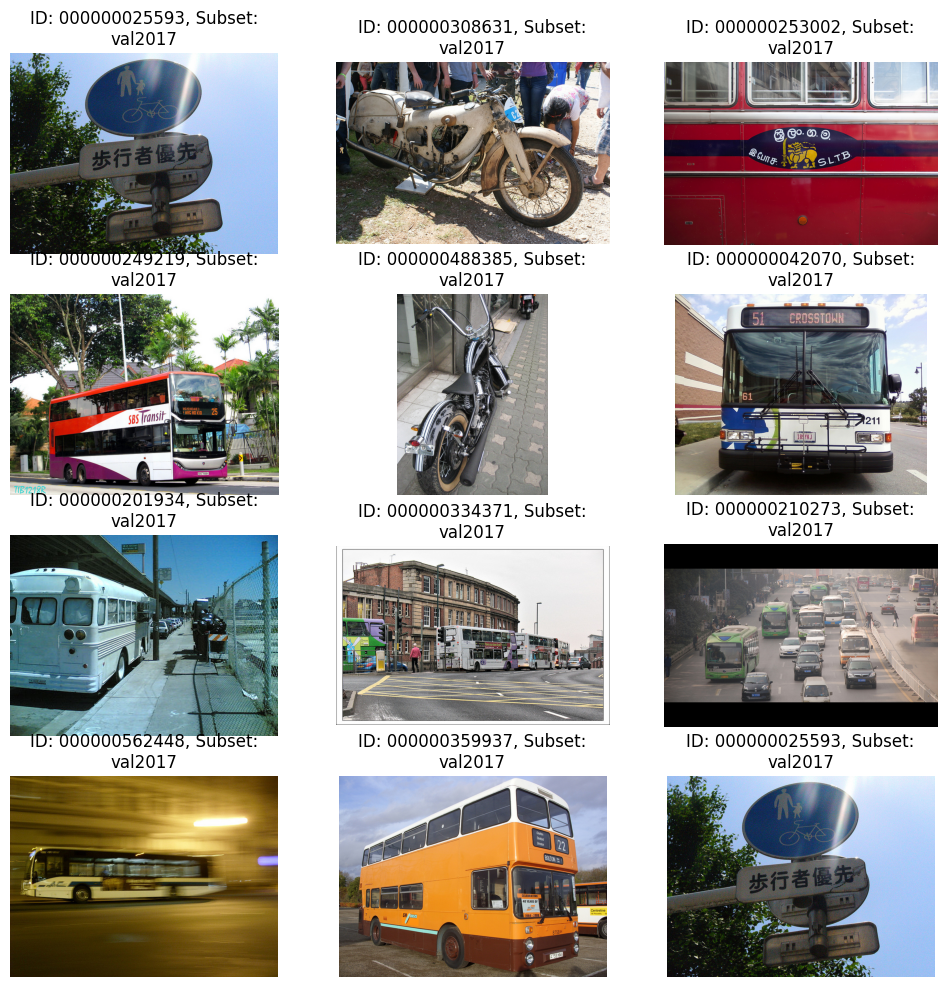

In [27]:
topk_list = searcher.search_topk(['motorcycle and bus and train'], topk=15)
results = topk_list[:]
subset_list = []
id_list =[]
for result in results:
    subset_list.append(result.subset)
    id_list.append(result.id)
fig = visualizer.vis_gallery(id_list[:12], subset_list[:12], (None, None))
fig.show()

### OV IR inference

In [28]:
start_time = time.time()
# dataset = dm.Dataset.import_from('./tests/assets/coco_dataset/coco', save_hash=True)
ir_dataset = dm.Dataset.import_from("coco_dataset", format='coco_instances', save_hash=True, hash_mode="ir")
# dataset = dm.Dataset.import_from("/media/hdd1/Datasets/imagenet/val", format='imagenet', save_hash=True)
print(f'setting dataset time for {len(ir_dataset)} items: ', time.time()-start_time)

5000it [38:28,  2.17it/s]


setting dataset time for 5000 items:  2311.077763557434


In [29]:
visualizer = Visualizer(ir_dataset, figsize=(12, 12), alpha=0)
searcher = Searcher(ir_dataset)

### Image query search

In [30]:
for i, item in enumerate(ir_dataset):
    if i==7:
        query = item

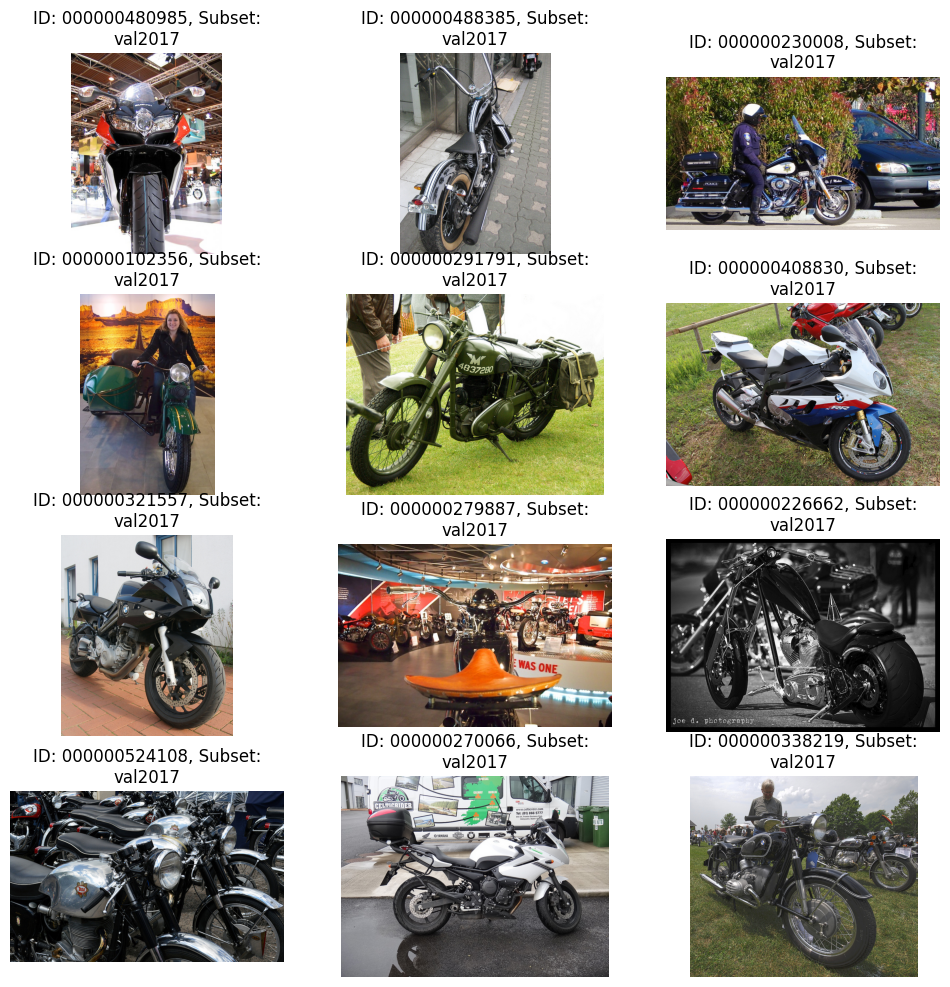

In [31]:
topk_list = searcher.search_topk(query, topk=15)
results = [query] + topk_list[1:]
subset_list = []
id_list =[]
for result in results:
    subset_list.append(result.subset)
    id_list.append(result.id)
fig = visualizer.vis_gallery(id_list[:12], subset_list[:12], (None, None))
fig.show()

### Text query search

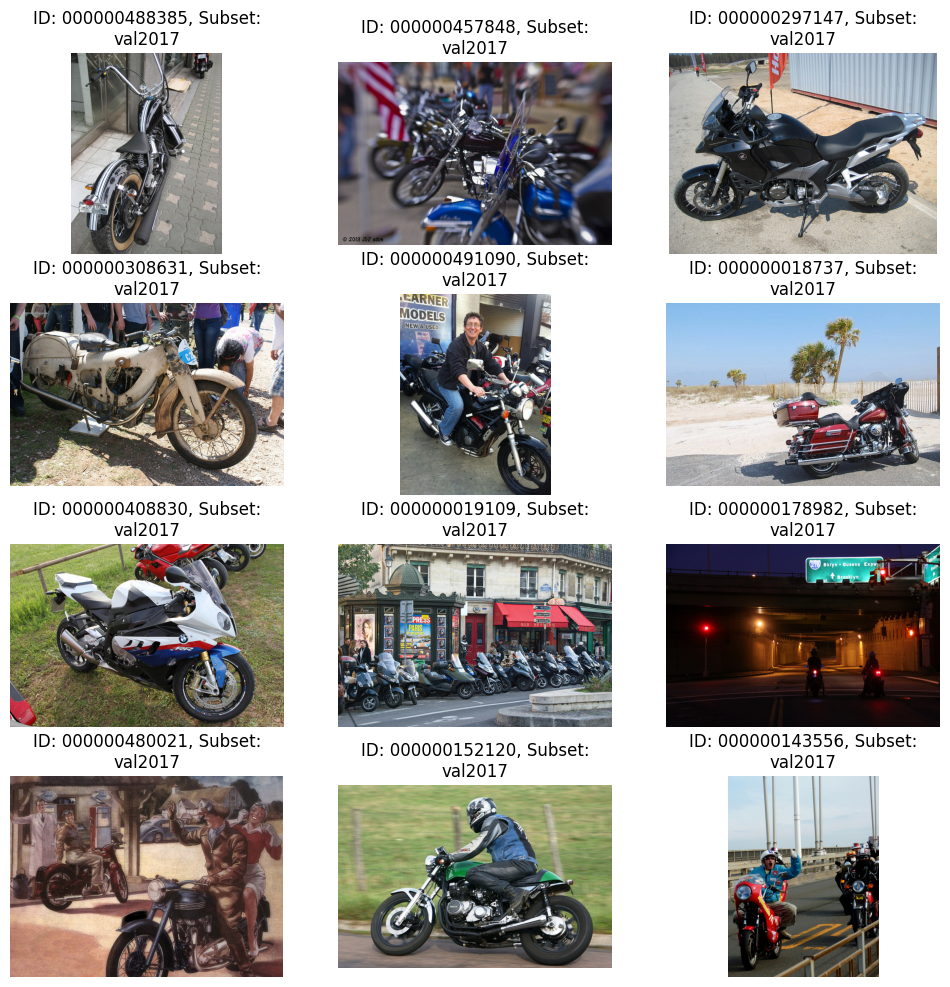

In [32]:
topk_list = searcher.search_topk('motorcycle', topk=15)
subset_list = []
id_list =[]
for result in topk_list:
    subset_list.append(result.subset)
    id_list.append(result.id)
fig = visualizer.vis_gallery(id_list[:12], subset_list[:12], (None, None))
fig.show()

### Image query list search

In [33]:
query_list = []
for i, item in enumerate(ir_dataset):
    if i in [7, 23, 31]: # 7-motorcycle, 23-bus, 26-giraffe, 31-train
        query_list.append(item)

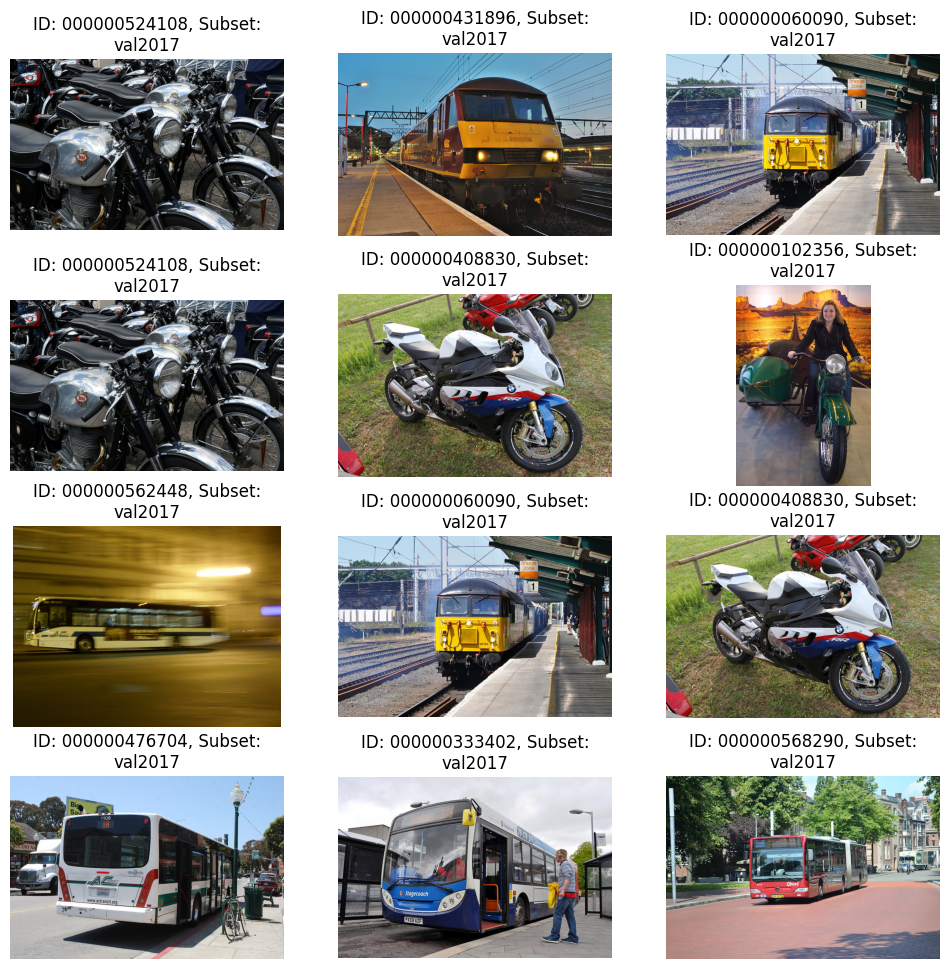

In [34]:
topk_list = searcher.search_topk(query_list, topk=15)
results = topk_list[:]
subset_list = []
id_list =[]
for result in results:
    subset_list.append(result.subset)
    id_list.append(result.id)
fig = visualizer.vis_gallery(id_list[:12], subset_list[:12], (None, None))
fig.show()

### Text query list search

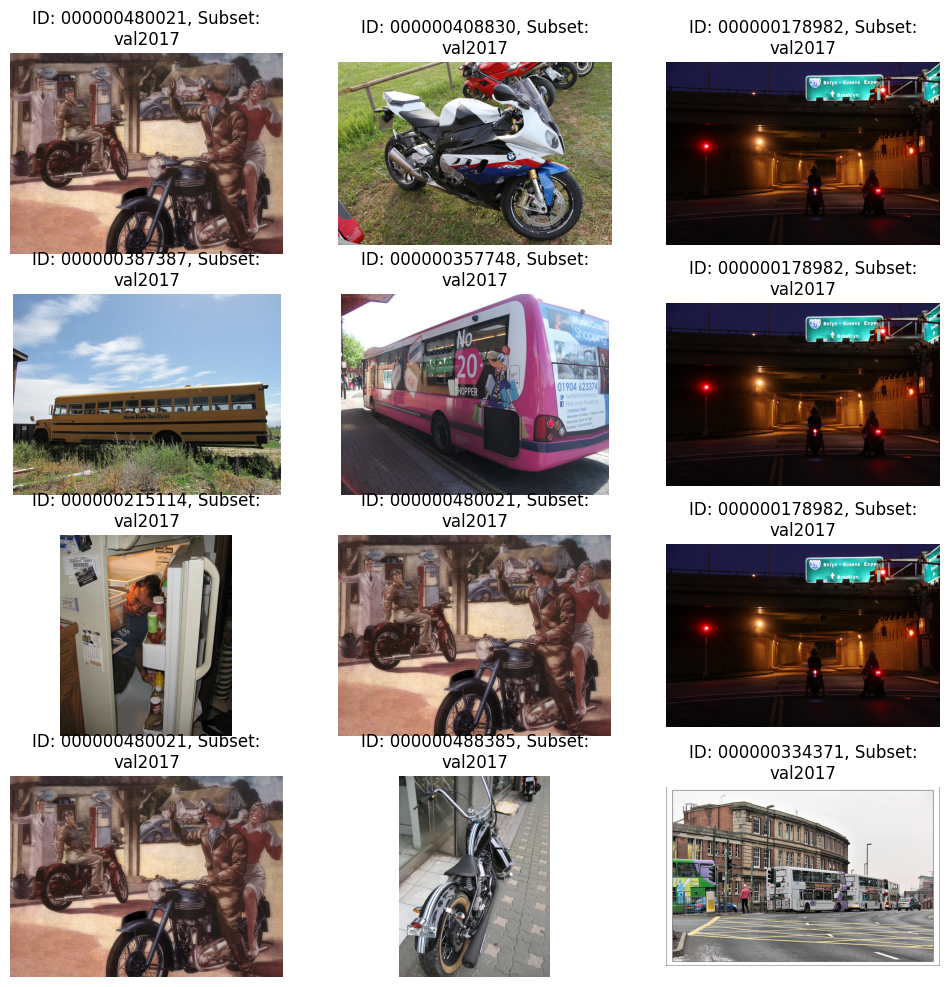

In [35]:
topk_list = searcher.search_topk(['motorcycle', 'bus', 'train'], topk=15)
results = topk_list[:]
subset_list = []
id_list =[]
for result in results:
    subset_list.append(result.subset)
    id_list.append(result.id)
fig = visualizer.vis_gallery(id_list[:12], subset_list[:12], (None, None))
fig.show()

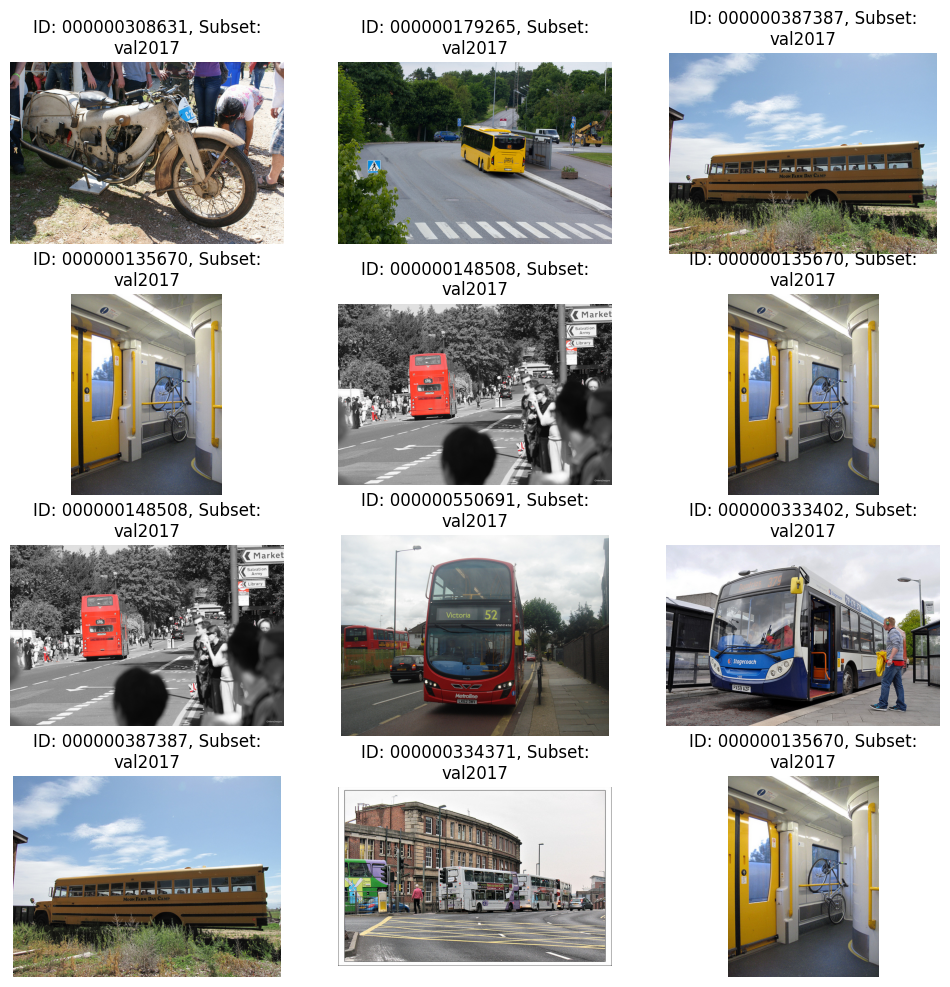

In [36]:
topk_list = searcher.search_topk(['motorcycle and bus and train'], topk=15)
results = topk_list[:]
subset_list = []
id_list =[]
for result in results:
    subset_list.append(result.subset)
    id_list.append(result.id)
fig = visualizer.vis_gallery(id_list[:12], subset_list[:12], (None, None))
fig.show()

## OV IR inference w/ INT8 model

In [2]:
start_time = time.time()
ir_in8_dataset = dm.Dataset.import_from("coco_dataset", format='coco_instances', save_hash=True, hash_mode="ir_int8")
print(f'setting dataset time for {len(ir_in8_dataset)} items: ', time.time()-start_time)

5000it [31:35,  2.64it/s]


setting dataset time for 5000 items:  1896.9782452583313


In [3]:
visualizer = Visualizer(ir_in8_dataset, figsize=(12, 12), alpha=0)
searcher = Searcher(ir_in8_dataset)

### Image query search

In [4]:
for i, item in enumerate(ir_in8_dataset):
    if i==7:
        query = item

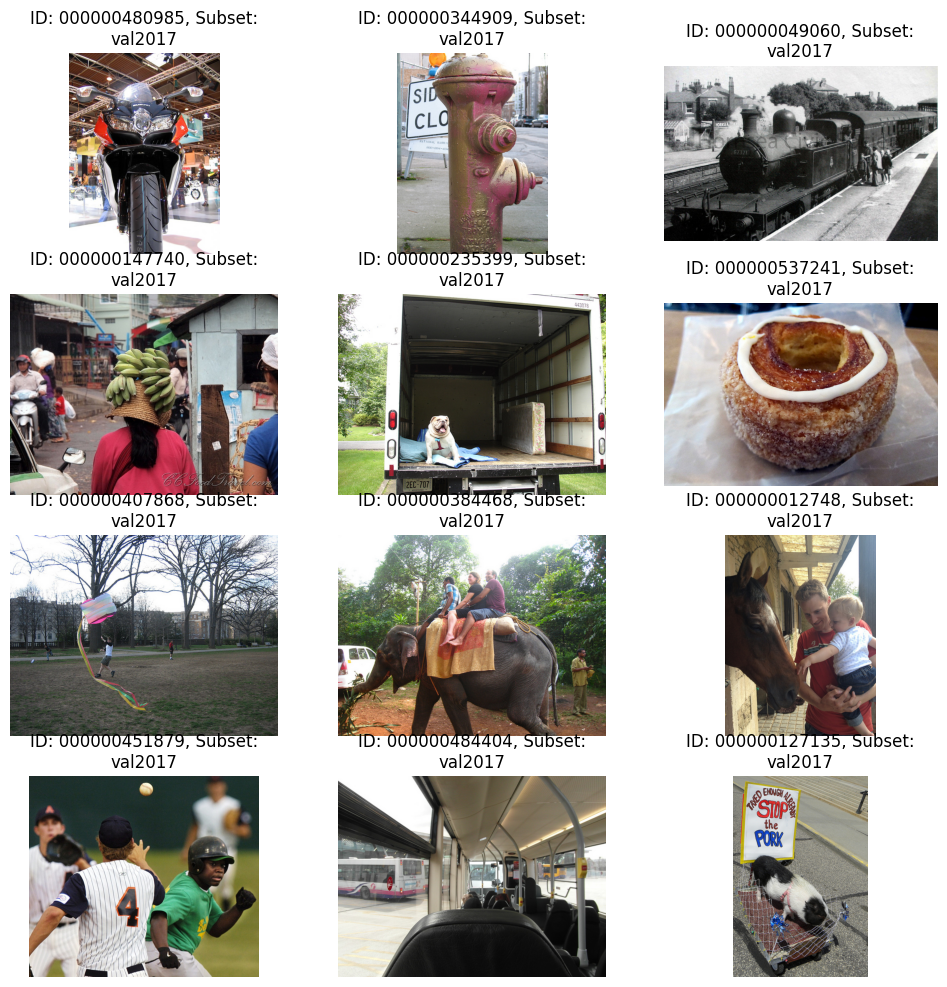

In [5]:
topk_list = searcher.search_topk(query, topk=15)
results = [query] + topk_list[1:]
subset_list = []
id_list =[]
for result in results:
    subset_list.append(result.subset)
    id_list.append(result.id)
fig = visualizer.vis_gallery(id_list[:12], subset_list[:12], (None, None))
fig.show()

### Text query search

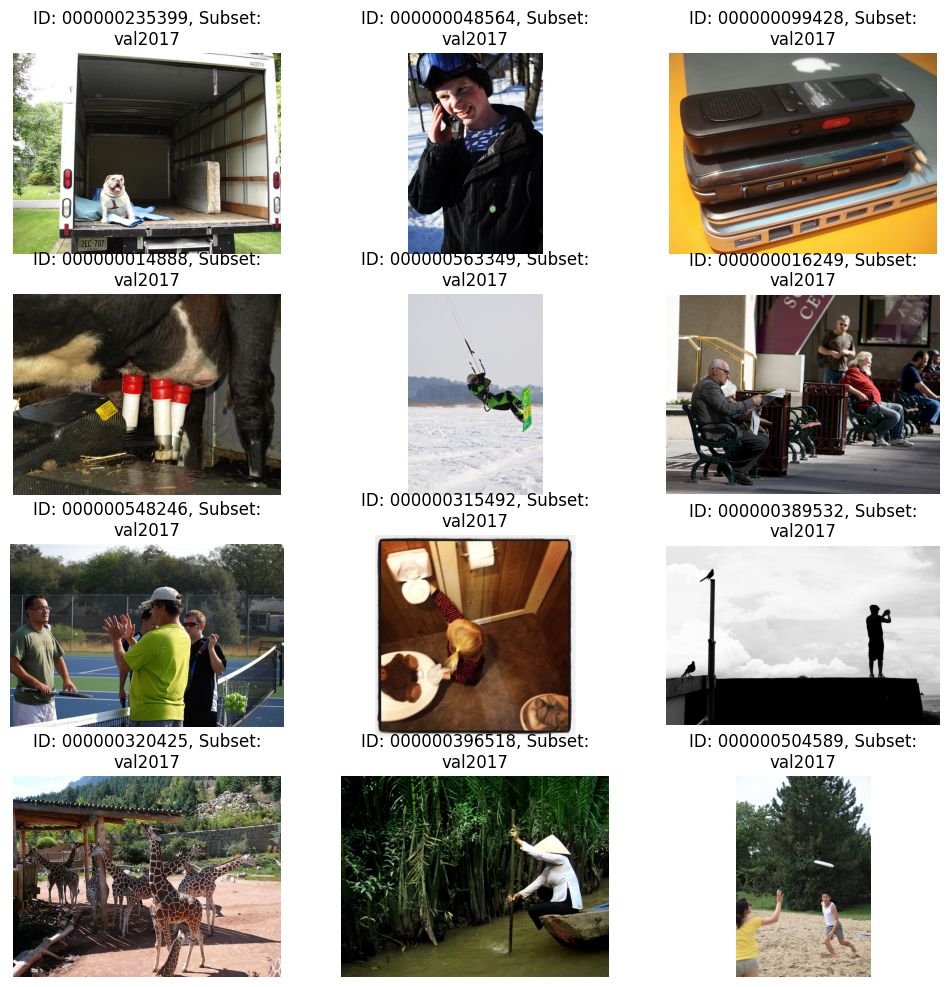

In [8]:
topk_list = searcher.search_topk('motorcycle', topk=15)
subset_list = []
id_list =[]
for result in topk_list:
    subset_list.append(result.subset)
    id_list.append(result.id)
fig = visualizer.vis_gallery(id_list[:12], subset_list[:12], (None, None))
fig.show()